In [2]:
import numpy as np
import cv2
from pathlib import Path
import matplotlib.pyplot as plt

from retrievalnet.evaluation import retrieval, is_gt_match_3D
from descriptor_index_pb2 import DescriptorIndex
from utils import plot_imgs
%load_ext autoreload
%autoreload 2

INDEX_ROOT = '../deep-relocalization/data/'
MAP_ROOT = '../deep-relocalization/'

In [3]:
ref_file = 'lindenhof_afternoon_aligned_mobilenet-d0.35.pb'
query_file = 'lindenhof_wet_aligned_mobilenet-d0.35.pb'

In [4]:
def get_index(name):
    index = DescriptorIndex()
    with open(Path(INDEX_ROOT, name).as_posix(), 'rb') as f:
        index.ParseFromString(f.read())
    return index
def get_data_from_index(index):
    positions = np.stack([f.position_vector.data for f in index.frames])
    rotations = np.stack([np.reshape(f.rotation_matrix.data, (3, 3), order='C') for f in index.frames])
    descriptors = np.stack([f.global_descriptor.data for f in index.frames])
    resources = np.stack([f.resource_name for f in index.frames])
    return {'pos': positions, 'rot': rotations, 'descriptors': descriptors, 'res': resources}
def get_image(index, i):
    path = Path(MAP_ROOT, index.data_name, 'resources/raw_images/', '%s.jpg' % index.frames[i].resource_name)
    return cv2.imread(path.as_posix())

In [5]:
ref_index = get_index(ref_file)
query_index = get_index(query_file)
ref_data = get_data_from_index(ref_index)
query_data = get_data_from_index(query_index)

# Ground truth matches

In [6]:
gt_matches = is_gt_match_3D(query_data, ref_data, distance_thresh=4, angle_thresh=70*np.pi/180.)
valid = np.any(gt_matches, axis=1)
print(np.mean(valid))

0.6754325259515571


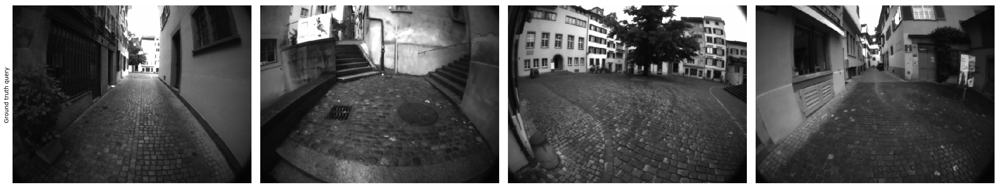

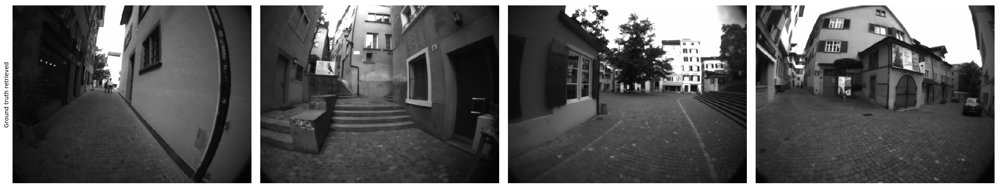

In [33]:
n_test = 4
test_idx = np.random.choice(np.where(valid)[0], size=n_test)
plot_imgs([get_image(query_index, i) for i in test_idx], ylabel='Ground truth query')
plot_imgs([get_image(ref_index, np.where(gt_matches[i])[0][0])  for i in test_idx], ylabel='Ground truth retrieved')

# Retrieval

In [9]:
retrieved = retrieval(ref_data['descriptors'], query_data['descriptors'], max_num_nn=5, pca_dim=512)
tp = gt_matches[np.expand_dims(np.arange(len(retrieved)), axis=1), retrieved]
hit = np.any(tp[valid], axis=1)
miss = np.logical_not(hit)
hit_idx = [retrieved[valid][i][np.where(tp[valid][i])[0]] for i in range(len(hit))]
miss_idx = [np.where(gt_matches[valid][i])[0] for i in range(len(miss))]
print('Accuracy on valid matches: {}'.format((np.mean(hit), np.sum(hit))))
print('Accuracy on all frames: {}'.format(np.mean(valid)*np.mean(hit)))

Accuracy on valid matches: (0.8780737704918032, 857)
Accuracy on all frames: 0.5930795847750865


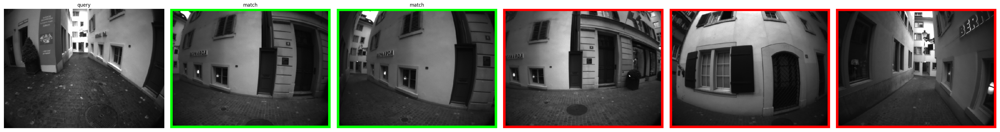

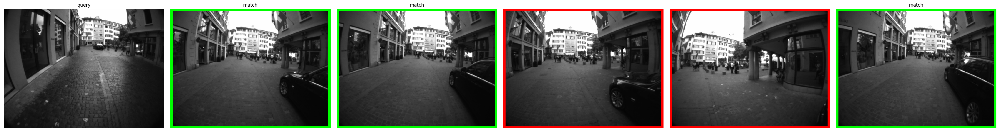

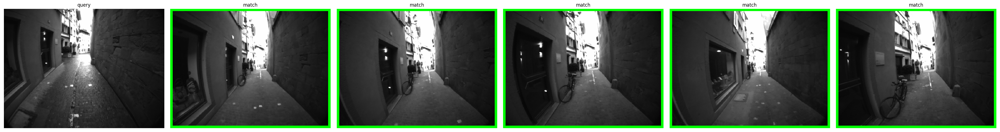

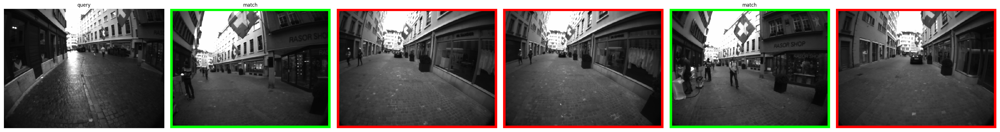

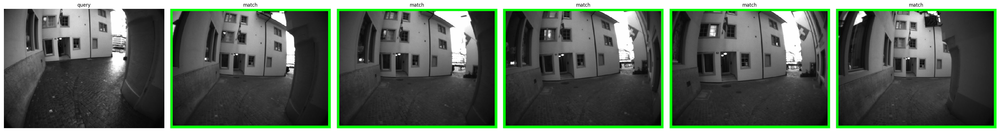

...

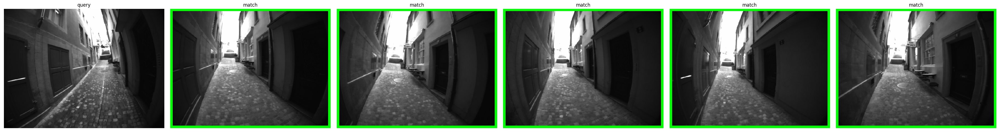

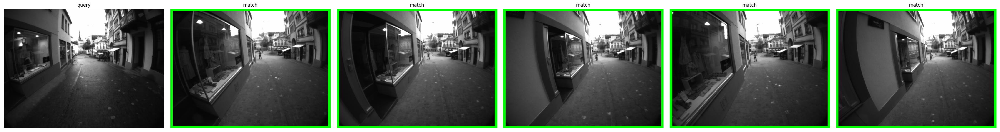

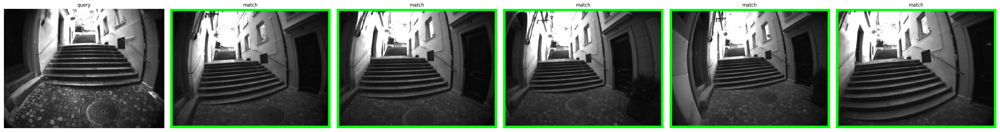

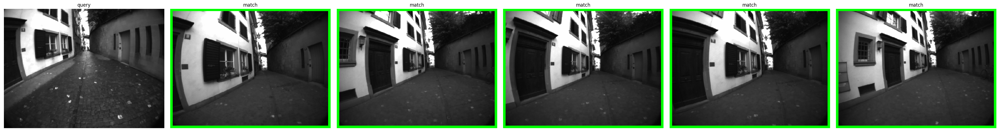

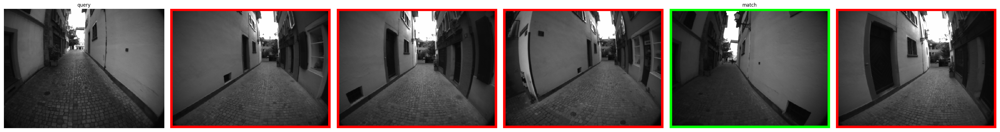

In [11]:
def add_frame(im, c, b=10):
    im[:, :b] = c
    im[:, -b:] = c
    im[:b, :] = c
    im[-b:, :] = c
    
n_test = 15
test_idx = np.random.choice(np.where(valid)[0], size=n_test)
for idx in test_idx:
    disp = [get_image(query_index, idx)]
    titles = ['query']
    for i in retrieved[idx]:
        im = get_image(ref_index, i)
        if gt_matches[idx][i]:
            add_frame(im, (0, 255, 0))
            titles.append('match')
        else:
            add_frame(im, (0, 0, 255))
            titles.append('')
        disp.append(im)
    plot_imgs(disp, titles=titles)

# Distribution of the number of correct counts per request

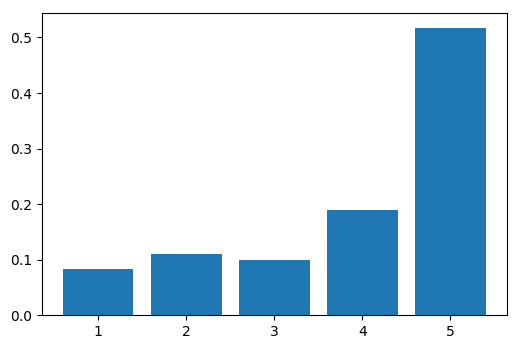

In [36]:
hit_cnt = np.sum(tp[valid][hit], axis=1)
plt.figure(dpi=100)
plt.bar(*(lambda i, c: (i, c/np.sum(c)))(*np.unique(hit_cnt, return_counts=True)));